# Instalaciones y carga de imagenes


In [1]:
from google.colab import files
uploaded = files.upload()

Saving uch012a.jpg to uch012a.jpg
Saving uch012b.jpg to uch012b.jpg
Saving uch084a.jpg to uch084a.jpg
Saving uch084b.jpg to uch084b.jpg
Saving uch098a.jpg to uch098a.jpg
Saving uch098b.jpg to uch098b.jpg
Saving uch101a.jpg to uch101a.jpg
Saving uch101b.jpg to uch101b.jpg


In [2]:
!ls

sample_data  uch012b.jpg  uch084b.jpg  uch098b.jpg  uch101b.jpg
uch012a.jpg  uch084a.jpg  uch098a.jpg  uch101a.jpg


In [3]:
!pip install sparse

     |████████████████████████████████| 81kB 2.2MB/s 
     |████████████████████████████████| 3.1MB 7.7MB/s 
     |████████████████████████████████| 24.6MB 1.8MB/s 
  Found existing installation: llvmlite 0.31.0
    Uninstalling llvmlite-0.31.0:
      Successfully uninstalled llvmlite-0.31.0
  Found existing installation: numba 0.48.0
    Uninstalling numba-0.48.0:
      Successfully uninstalled numba-0.48.0


In [4]:
!pip install ipython-autotime

In [5]:
!pip install -U opencv-python

     |████████████████████████████████| 49.5MB 67kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30


In [6]:
%load_ext autotime

time: 88.2 µs


In [7]:
from google.colab.patches import cv2_imshow
import numpy
import cv2

time: 448 ms


# Introducción


En el presente documento se presenta tanto el procedimiento, como los resultados obtenidos durante el desarrollo de la tercera tarea del curso EL7008. En esta, se implementan y analizan los métodos de RANSAC, Hough para la detección de objetos a partir de descriptores SIFT y se prueban sobre un conjunto de imágenes. 

A continuación, se listan las secciones principales del informe:

- Desarrollo
    - Transformación de semejanza: Se explica y programa una función para calcular la transformación de semejanza.
    - Ransac:  Se explica y programa una función para aplicar el método de Ransac.
    - Hough:  Se explica y programa el método de Hough.
    - Transformación Afín:  Se explica y programa la transformación afín a partir de un conjunto de calces.
    - Dibujo de romboide: Programación de la función para dibujar la proyeción.
    - Función auxiliar para mostrar resultados.
- Resultados: Se muestran los resultados de los métodos de Ransac y Hough, además se muestran los efectos al variar sus parámetros.
- Ventajas y desventajas de ambos métodos.
- Conclusiones.

# Transformación de semejanza

Se programa la función para calcular los parámetros $e$, $\theta$, $tx$ y $ty$, de la transformación de semejanza, a partir de un calce, mediante las siguientes ecuaciones:

$$ e = \frac{\sigma_{pru}}{\sigma_{ref}} $$

$$ \theta = \varphi_{pru} -\varphi_{ref} $$

$$ tx = x_{pru} - e(x_{ref} cos( \theta) - y_{ref}sin(\theta)) $$

$$ ty = y_{pru} - e(x_{ref} sin( \theta) - y_{ref}cos(\theta)) $$


In [8]:
import math

def genTransform(match, keypoints1, keypoints2):

  kp1, kp2 = keypoints1[match.queryIdx], keypoints2[match.trainIdx]
  x_ref, y_ref = kp1.pt
  x_pru, y_pru = kp2.pt

  e = kp2.size / kp1.size
  theta = np.pi*(kp2.angle - kp1.angle)/180
  tx = x_pru - e*(x_ref*np.cos(theta) - y_ref*np.sin(theta))
  ty = y_pru - e*(x_ref*np.sin(theta) + y_ref*np.cos(theta))

  return e, theta, tx, ty

time: 6.34 ms


# Ransac

A continuación, se muestra la función *ransac*, la cual implementa el método de Ransac sobre un conjunto de calces.
Para esto, en primer lugar, es necesario que la función reciba como parámetros, los calces (*matches*), y los *keypoints* de las imágenes de prueba y de referencia. Además, en este caso se agregan los parámetros del método de Ransac, los cuales son:

- **k**: Número de selecciones de calces al azar para generar hipótesis.
- **t**: Máximo error que puede tener una proyección para ser considerada como concenso.
- **min_concenso**: Mínima cantidad de concensos que debe tener una hipótesis para ser aceptada.

Así, la función itera **k** veces mediante un bucle *while*, y en cada iteración escoge un calce al azar, con el cual:

- Calcula la transformación de semejanza mediante genTransform.

- Evalua la transformación encontrada (proyecta los puntos de la imagen de referencia, en la imagen de prueba), sobre todos los calces mediante un ciclo *for*.

- Con lo anterior, se mide el error cuadrático de la proyección en cada caso y si éste es menor al umbral **t**, se agrega este calce a la lista *concenso*.

- Una vez terminado el ciclo *for*, se evalua si la cantidad de concensos encontrados es mayor al **min_concenso**, y además es mayor al concenso con mas votos encontrado hasta el momento, guardado en la variable *accepted*. Si se cumplen ambas condiciones se asigna la lista *concenso* a la variable *accepted* indicando que es la mejor hipótesis encontrada.

Finalmente, se retorna la lista *accepted*, la cual contiene los calces pertenecientes a la hipótesis con más votos.



In [9]:
import random


def ransac(matches, keypoints1, keypoints2, k = 100, t = 100, min_concenso = 30):
  accepted = []

  while k >= 0:
    idx = random.randint(0, len(matches)-1)
    match = matches[idx]
    concenso = []
    e, theta, tx, ty = genTransform(match, keypoints1, keypoints2)

    for match_eval in matches:
      kp1, kp2 = keypoints1[match_eval.queryIdx], keypoints2[match_eval.trainIdx]
      x_ref, y_ref = kp1.pt
      x_pru, y_pru = kp2.pt    

      x_pru_pr = e*(np.cos(theta)*x_ref - np.sin(theta)*y_ref) + tx
      y_pru_pr = e*(np.sin(theta)*x_ref + np.cos(theta)*y_ref) + ty
      error = np.sqrt((x_pru-x_pru_pr)**2 + (y_pru - y_pru_pr)**2)
      if error < t:
        concenso.append(match_eval)

    if len(concenso) > len(accepted) and len(concenso) > min_concenso:
      accepted = concenso
    k-=1  
 

  return accepted

time: 23.9 ms


# Hough

A continuación, se muestra la función *hough4d*, la cual implementa el método de Hough sobre un conjunto de calces.
Para esto, en primer lugar, es necesario que la función reciba como parámetros, los calces (*matches*), y los *keypoints* de las imágenes de prueba y de referencia, al igual que el método de Ransac. Además, en este caso se agregan los parámetros propios de este método, los cuales son:

- *dxBin*: tamaño de la discretización del largo del vector posición en su representación polar.
- *dangBin*: tamaño de la discretización ángulo del vector posición en su representación polar.
- *umbralvotos*: Mínima cantidad de votos para aceptar la hipótesis.


Con esto, en primer lugar se recorren todos los matches, y para cada uno se calcula su transformación de semejanza. Luego, se discretiza el espacio de las transformaciones de semejanza mediante las siguientes ecuaciones:

$$ i = floor\left( \frac{tx}{dxBin}  + 0.5 \right)  + 500 $$
$$ j = floor\left( \frac{ty}{dxBin}  + 0.5 \right)  + 500 $$
$$ k = floor\left( \frac{\theta}{dangBin}  + 0.5 \right)  + 500 $$
$$ z = floor\left( \frac{log(e)}{log(2)}  + 0.5 \right)  + 500 $$

Con esto se obtienen los índices $[i, j, k, z]$ para cada match y se guardan en la lista *stored*.

Así, lo que debiese ocurrir, es que una cierta cantidad de matches obtengan los mismos valores para sus índices discretizados. Es por esto, que cada tupla $[i, j, k, z]$ calculada, se considera un voto, y se escogerá el mayor conjunto de calces que voten por los mismos índices.

Luego de recorrer todos los calces, se transforma la lista *stored* en una matriz sparse, con la cual es posible obtener fácilmente cual fue la máxima cantidad de votos que tuvo una tupla.

Finalmente, una vez conocido el máximo de votos, se comprueba si éste es mayor al umbral mínimo definido como parámetro. En caso de no ser mayor, significa que no se acepta ningun conjunto de calces y se retorna una lista vacía. 
Por otro lado, si es mayor, se recorre la lista de índices *stored* y se evalúa en la matriz *sparse* **sm**, considerando que el resultado de evaluar $sm[i, j, k, z]$ es la cantidad de votos que obtuvo esa tupla. Así, si se cumple que esa tupla es parte del conjunto que obtuvo más votos, se agrega el match asociado a esos índices a la lista *accepted*.

Para asociar una tupla con su respectivo match, se hace uso del iterable incorporado de python *enumerate*, el cual recibe otro iterable (como por ejemplo una lista), y retorna tuplas (i, x), donde x es el elemento en la lista y el índice *i* corresponde a la posición del elemento en la lista. Como el cáculo de los elementos en *stored* se hizo de forma ordenada, *stored[i]*, corresponde a la tupla calculada a partir del calce *matches[i]*

Finalmente se retorna la lista accepted, que corresponde a los matches que tuvieron mayor concenso.

In [10]:
import sparse
def hough4d(matches, keypoints1, keypoints2, dxBin = 60, dangBin = 30, umbralvotos = 4):
  stored = []
  maxvotos = 0
  # Parametros de Hough 
  dangBin = dangBin * math.pi / 180
  accepted = []

 
  for match in matches:
    e, theta, tx, ty = genTransform(match, keypoints1, keypoints2)
    i = np.floor(tx/dxBin + 0.5) + 500
    j = np.floor(ty/dxBin + 0.5) + 500
    k = np.floor(theta/dangBin + 0.5) + 500
    z = np.floor(np.log(e)/np.log(2) + 0.5) + 500

    stored.append([i, j, k, z])
    
  if len(stored) == 0:
    return []
  coords = np.transpose( np.array(stored) )
  data = np.ones( len(stored) )
  sm = sparse.COO(coords, data, shape=((1000,) * 4))

  maxvotos = np.max(sm.data)
  if maxvotos < umbralvotos:
    return []

  for i, indices in enumerate(stored):
    indices = np.array(indices, dtype = int)
    if sm[indices[0], indices[1], indices[2], indices[3]] == maxvotos:
      accepted.append(matches[i])
  return accepted
  

time: 415 ms


# Transformación afín

La transformación afín, de un punto $(x,y)$, se define como:

\begin{equation}
\binom{x_{pru}}{y_{pru}} = \begin{pmatrix}
m_{xx} & m_{xy} \\ 
m_{yx} & m_{yy}
\end{pmatrix} \binom{x_{ref}}{y_{ref}} + \binom{t_x}{y_y} 
\end{equation}

Alternativamente, se puede escribir como:

$$
\binom{x_{pru}}{y_{pru}} = \begin{pmatrix}
x_{ref} &  y_{ref}& 0 & 0 & 1 & 0\\ 
0 &  0& x_{ref} & y_{ref} & 0 & 1
\end{pmatrix}\begin{pmatrix}
m_{xx} & m_{xy}  & m_{yx} & m_{yy} & t_x & t_y
\end{pmatrix}^T
$$

Lo que se puede escribir como:

$$b = A \cdot x $$

Además, un conjunto de N puntos $\{(x_i,y_i)\}_{i=1}^N$, se puede escribir de forma vectorial como:

$$ X_{ref} = \begin{pmatrix}
x_1\\ 
x_2\\ 
.\\ 
.\\ 
.\\ 
x_N
\end{pmatrix} \;\;\;  \;\;\;  Y_{ref} = \begin{pmatrix}
y_1\\ 
y_2\\ 
.\\ 
.\\ 
.\\ 
y_N
\end{pmatrix}$$

y con esto, reemplazado en la matriz A, para encontrar los parámetros de la matriz x, se puede minimizar mediante mínimos cuadrados:

$$ argmin_x ||A\cdot x- b||^2$$

$$x^* = (A^TA)^{-1}A^Tb $$

Con lo anterior, la función *calcAfin*, calcula la transformación afín mediante mínimos cuadrados, a partir de un conjunto de calces. Para esto, en primer lugar, se extraen las coordenadas $(x_{ref},y_{ref})$ y $(x_{pru}, y_{pru})$ y se almacenan en forma vectorial.

Luego, se crean contenedores para las matrices A y b, con dimensiones $2N x 6$ y $2N$, respectivamente, con N igual al numero de calces.

Finalmente, se reemplazan los valores de los vectores que contienen las coordenadas en las matrices A y b utilizando las ecuaciones anteriores, y se calculan los valored de la matriz *x*.

In [11]:
def calcAfin(matches, keypoints1, keypoints2):
  # Por hacer: calcular la transformacion afin mediante minimos cuadrados a partir de "matches"
  X_ref, X_pru, Y_ref, Y_pru = [], [], [], []
  for match in matches:
    kp1, kp2 = keypoints1[match.queryIdx], keypoints2[match.trainIdx]
    x_ref, y_ref = kp1.pt
    x_pru, y_pru = kp2.pt

    X_ref.append(x_ref)
    Y_ref.append(y_ref)
    X_pru.append(x_pru)
    Y_pru.append(y_pru)
  X_ref, X_pru, Y_ref, Y_pru = np.array(X_ref), np.array(X_pru), np.array(Y_ref), np.array(Y_pru)
  A = np.zeros((2*len(matches), 6))
  b = np.zeros(2*len(matches))

  A[:len(matches),0] = X_ref
  A[:len(matches),1] = Y_ref
  A[len(matches):,2] = X_ref
  A[len(matches):,3] = Y_ref
  A[:len(matches),4] = np.ones(len(matches))  
  A[len(matches):,5] = np.ones(len(matches))  

  b[:len(matches)] = X_pru
  b[len(matches):] = Y_pru

  inv = np.linalg.pinv(np.matmul(A.T, A))
  aux = np.matmul(inv, A.T) 
  x = np.matmul(aux, b)
  return x

time: 22.7 ms


# Dibujo de romboide

Para dibujar el romboide a partir de una transformación afín, se programa la función *drawProjAfin*, la cual recibe como parámetros:

- transf: matriz x obtenida mediante la función *calcAfin*, la cual define una transformación afín.
- input1: imagen sobre la cual se dibujará el romboide.
- input2: imagen a proyectar sobre la imagen input1.

Para hacer la proyección, se toman las cuatro esquinas de la imagen input2, y se proyectan haciendo una transformación afín mediante la ecuación:

$$
\binom{x_{pru}}{y_{pru}} = \begin{pmatrix}
x_{ref} &  y_{ref}& 0 & 0 & 1 & 0\\ 
0 &  0& x_{ref} & y_{ref} & 0 & 1
\end{pmatrix}transf^T
$$

con esto, se obtienen las cuatro esquinas del romboide a graficar sobre el input1. 
Finalmente se trazan líneas mediante el método *line* de opencv, el cual dibuja una línea entre dos puntos sobre una imagen.




In [12]:
def drawProjAfin(transf, input1, input2):
  # Por hacer:
  # Dibujar un romboide que represente el rectangulo de la imagen "input2" proyectada en la imagen "input1"
 

  x_ref, y_ref = 0, 0   #esquina sup izq
  p1 = np.matmul(np.array([[x_ref,y_ref,0,0,1,0],[0,0,x_ref,y_ref,0,1]]), transf.T )

  x_ref, y_ref = 0, input2.shape[0] #esquina sup der
  p2 = np.matmul(np.array([[x_ref,y_ref,0,0,1,0],[0,0,x_ref,y_ref,0,1]]), transf.T )

  x_ref, y_ref = input2.shape[1], 0 #esquina inf izq
  p3 = np.matmul(np.array([[x_ref,y_ref,0,0,1,0],[0,0,x_ref,y_ref,0,1]]), transf.T )

  x_ref, y_ref = input2.shape[1], input2.shape[0] #esquina inf der
  p4 = np.matmul(np.array([[x_ref,y_ref,0,0,1,0],[0,0,x_ref,y_ref,0,1]]), transf.T )


  

  p1 = tuple(p1.astype(int))
  p2 = tuple(p2.astype(int))
  p3 = tuple(p3.astype(int))
  p4 = tuple(p4.astype(int))

  cv2.line(input1, p1, p2, (256,256,256))
  cv2.line(input1, p2, p4, (256,256,256))
  cv2.line(input1, p4, p3, (256,256,256))
  cv2.line(input1, p3, p1, (256,256,256))
  return input1


time: 23.1 ms


# Función auxiliar Filter Matches

**Se agregaron los parámetros kp1 y kp2 para que no utilize variables globales.**

In [13]:
# Esta funcion ya esta lista, no debe ser modificada
def filterMatches(matches, kp1, kp2):
  # Apply ratio test
  points1 = []
  points2 = []
  good = []

  for m,n in matches:
    if m.distance < 0.75*n.distance:  # 0.75
      good.append(m)
      points1.append(kp1[m.queryIdx].pt)
      points2.append(kp2[m.trainIdx].pt)
  return np.array(points1), np.array(points2), good

time: 6.16 ms


# Función auxiliar para mostrar los resultados


A continuación se crean funciones auxiliares para mostrar los resultados tanto para el método de Ransac como el de Hough. En ambas, se muestra el conjunto de matches inicial, luego los matches escogidos por el método respectivo y finalmente la detección del objeto graficando el romboide sobre la imagen de prueba.

## Ransac

In [14]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

def show_results_ransac(im1, im2, k = 100, t = 100, min_concenso = 30):
  img1 = cv2.imread(im1,0)
  img2 = cv2.imread(im2,0)


  sift = cv2.SIFT_create()

  kp1, des1 = sift.detectAndCompute(img1,None)
  kp2, des2 = sift.detectAndCompute(img2,None)

  bf = cv2.BFMatcher()
  matches = bf.knnMatch(des1,des2, k=2)
  points1, points2, good = filterMatches(matches, kp1, kp2)

  img_match = cv2.drawMatches(img1,kp1,img2,kp2,good, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

  print('Calces iniciales')
  cv2_imshow(img_match)
  
  
  m = ransac(good, kp1, kp2, k, t, min_concenso)
  
  img_match_filter = cv2.drawMatches(img1,kp1,img2,kp2,m, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  print('Calces aceptados mediante el método de Ransac')
  cv2_imshow(img_match_filter)

  transf = calcAfin(m, kp1, kp2)
  input2 = drawProjAfin(transf, img2, img1)

  print('Resultado obtenido de la proyección con el método de Ransac')
  cv2_imshow(input2)


time: 28.6 ms


## Hough

In [15]:
def show_results_hough(im1, im2, dxBin = 60, dangBin = 30, umbralvotos = 4):
  img1 = cv2.imread(im1,0)
  img2 = cv2.imread(im2,0)


  sift = cv2.SIFT_create()

  kp1, des1 = sift.detectAndCompute(img1,None)
  kp2, des2 = sift.detectAndCompute(img2,None)

  bf = cv2.BFMatcher()
  matches = bf.knnMatch(des1,des2, k=2)
  points1, points2, good = filterMatches(matches, kp1, kp2)

  img_match = cv2.drawMatches(img1,kp1,img2,kp2,good, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

  print('Calces iniciales')
  cv2_imshow(img_match)
  
  
  m = hough4d(good, kp1, kp2, dxBin, dangBin, umbralvotos)
  
  img_match_filter = cv2.drawMatches(img1,kp1,img2,kp2,m, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  print('Calces aceptados mediante el método de Hough')
  cv2_imshow(img_match_filter)

  transf = calcAfin(m, kp1, kp2)
  input2 = drawProjAfin(transf, img2, img1)

  print('Resultado obtenido de la proyección con el método de Hough')
  cv2_imshow(input2)  

time: 20.9 ms


# Resultados

## Método de Ransac

Se ejecuta el método de Ransac sobre las 4 imágenes de prueba. Se puede observar que el método escoge de forma efectiva los calces correctos, eliminando en gran medida los erróneos. En todos los casos, queda una cantidad considerable de calces correctos (a excepción de la imagen 4), con lo cual es posible calcular una buena transformación afín. Así, es posible identificar el objeto en la imagen de prueba.

Como era de esperarse, en la imagen 4, la cual corresponde a objetos diferentes, no se obtienen calces correctos, y por ende no es posible identificar el objeto en la imagen de prueba.

Un caso que puede ser interesante, es la imagen 3, en la cual el objeto posee una rotación fuera del plano en la imagen de prueba. En esta detección, se puede observar que la proyección es más imprecisa que en los otros dos casos correctos, lo que puede dar cuenta que el método es robusto ante rotaciones dentro del plano, pero no tanto fuera de él.


### Imagen 1

Calces iniciales


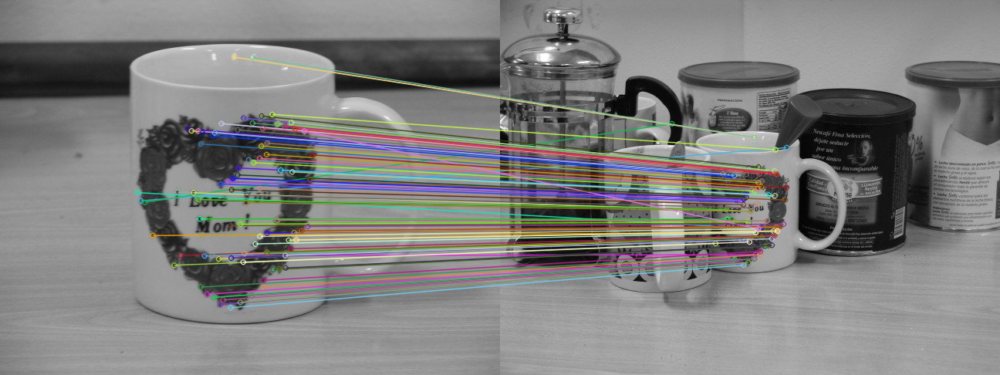

Calces aceptados mediante el método de Ransac


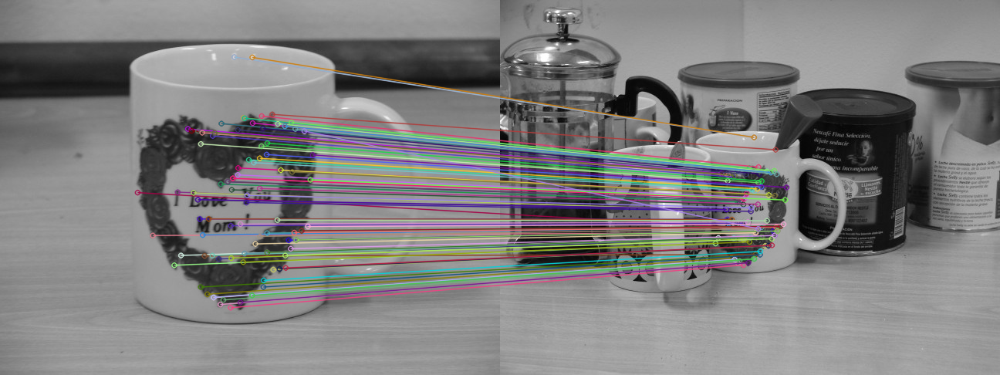

Resultado obtenido de la proyección con el método de Ransac


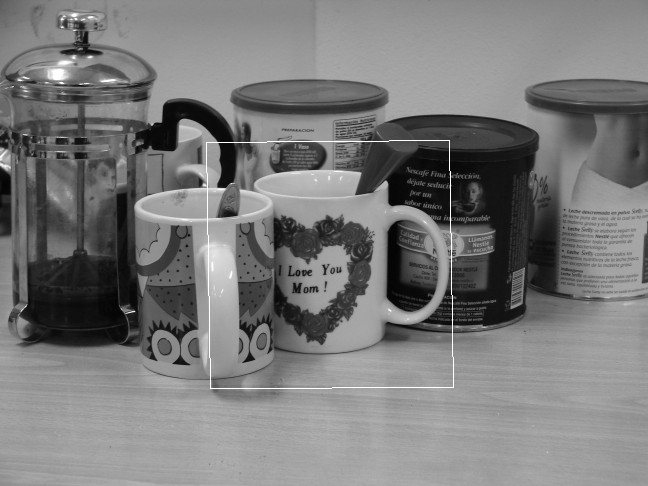

time: 972 ms


In [ ]:
show_results_ransac('uch012a.jpg','uch012b.jpg')

### Imagen 2

Calces iniciales


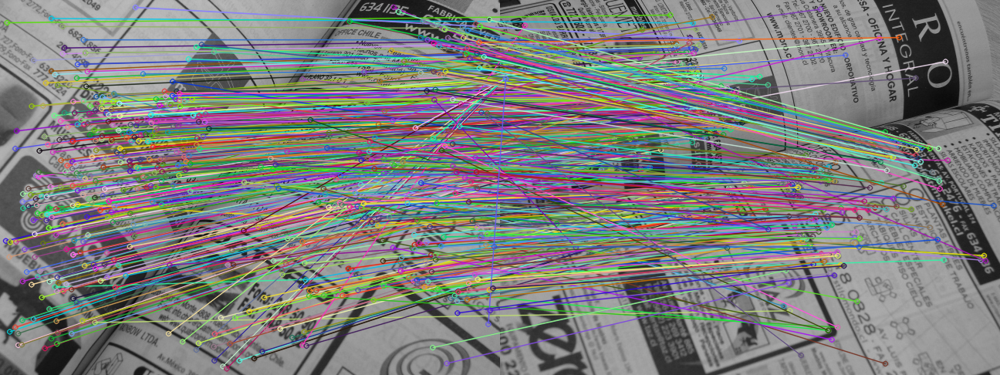

Calces aceptados mediante el método de Ransac


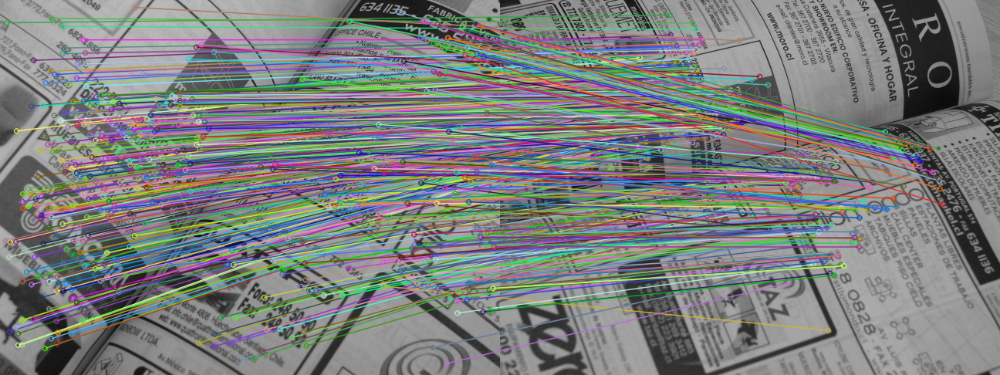

Resultado obtenido de la proyección con el método de Ransac


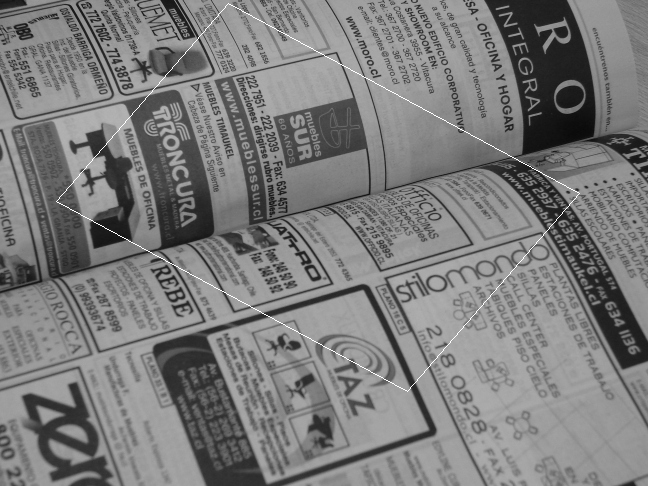

time: 2.17 s


In [ ]:
show_results_ransac('uch084a.jpg','uch084b.jpg')

### Imagen 3

Calces iniciales


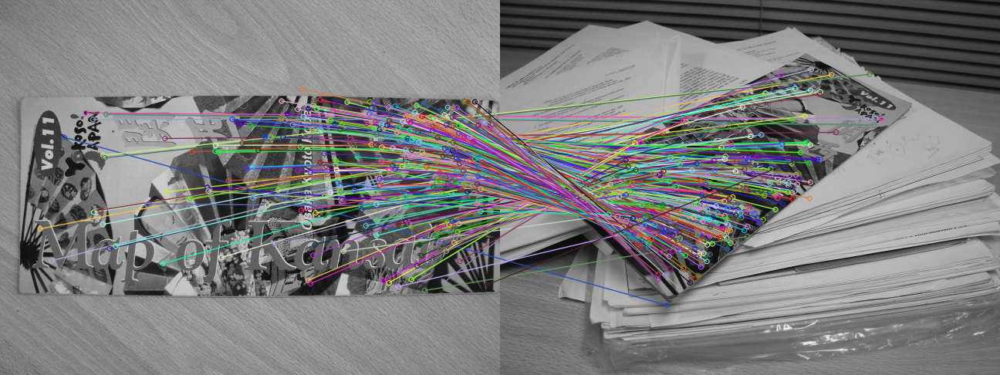

Calces aceptados mediante el método de Ransac


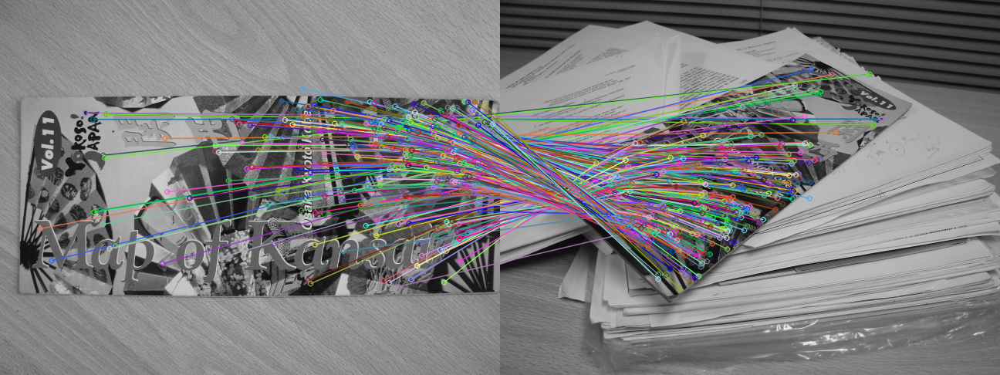

Resultado obtenido de la proyección con el método de Ransac


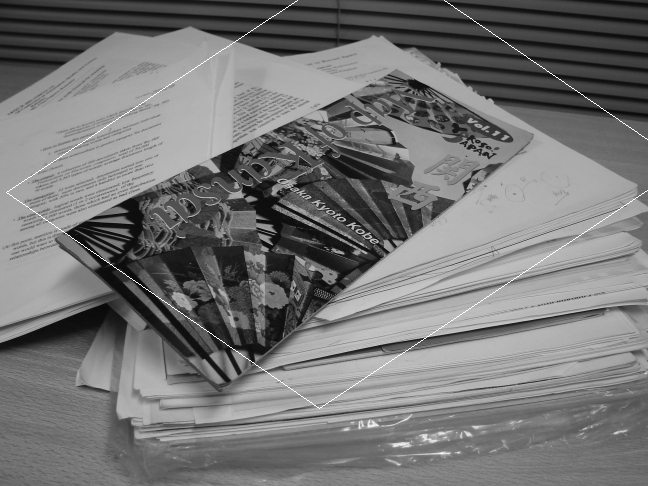

time: 1.47 s


In [ ]:
show_results_ransac('uch098a.jpg','uch098b.jpg')

### Imagen 4

Calces iniciales


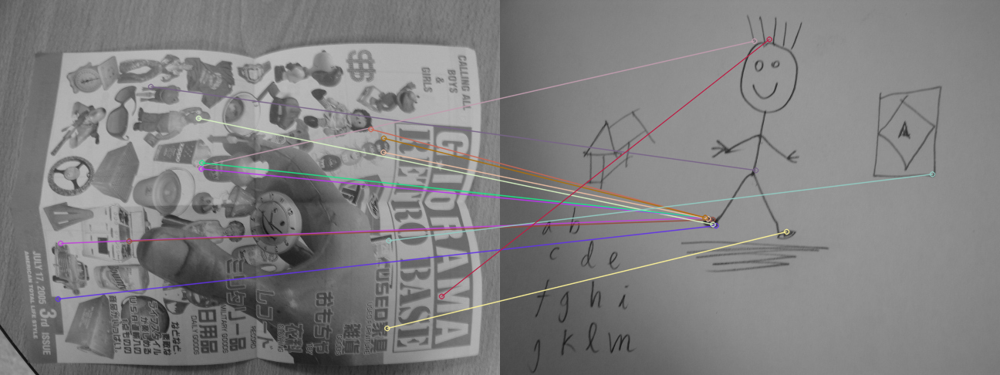

Calces aceptados mediante el método de Ransac


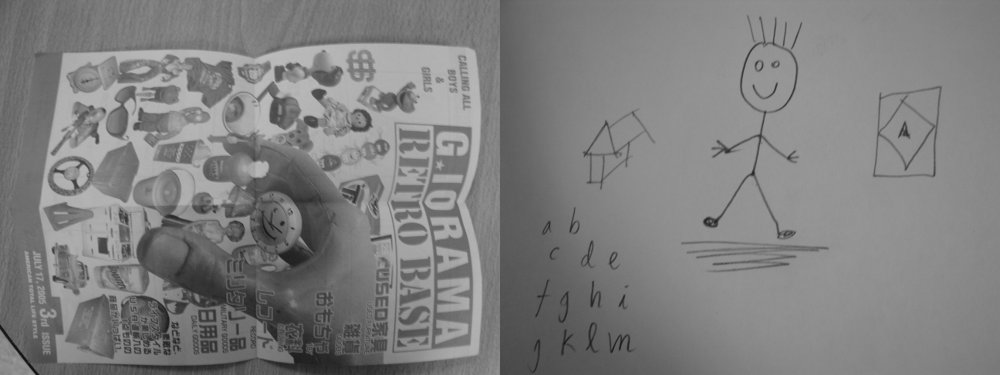

Resultado obtenido de la proyección con el método de Ransac


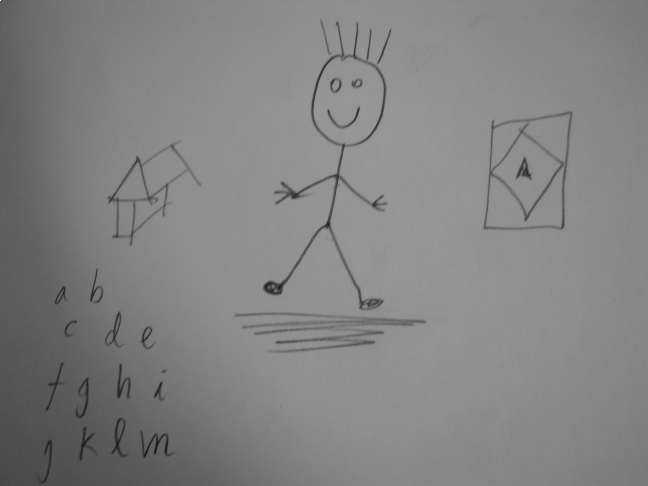

time: 1.01 s


In [ ]:
show_results_ransac('uch101a.jpg','uch101b.jpg')

## Método de Hough

Se obtienen resultados similares al método de Ransac, pero se puede notar que se filtra una mayor cantidad de calces, y por ende, las transformaciones afines se hacen con una muestra menor de éstos. Lo anterior, resulta en general, en proyecciones un poco menos precisas principalmente cuando existen rotaciones fuera del plano. Esto se puede evidenciar nuevamente para la imagen 3, en donde la cantidad de calces aceptados es muy pequeña y la proyección resultante es peor que en el caso anterior.

### Imagen 1

Calces iniciales


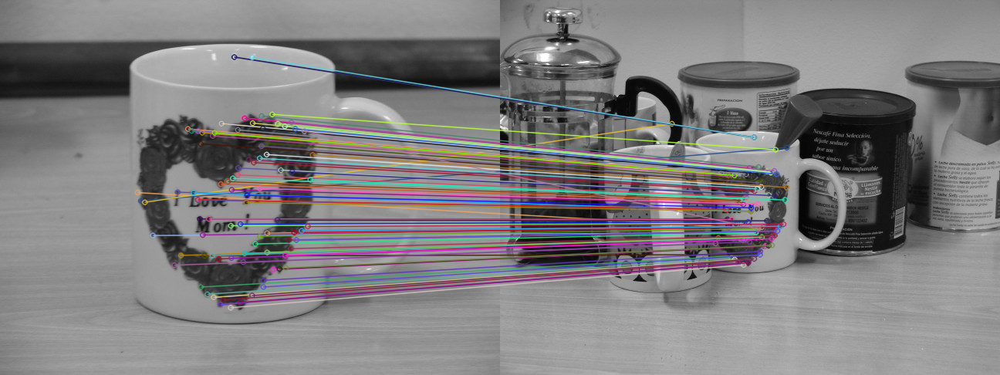

Calces aceptados mediante el método de Hough


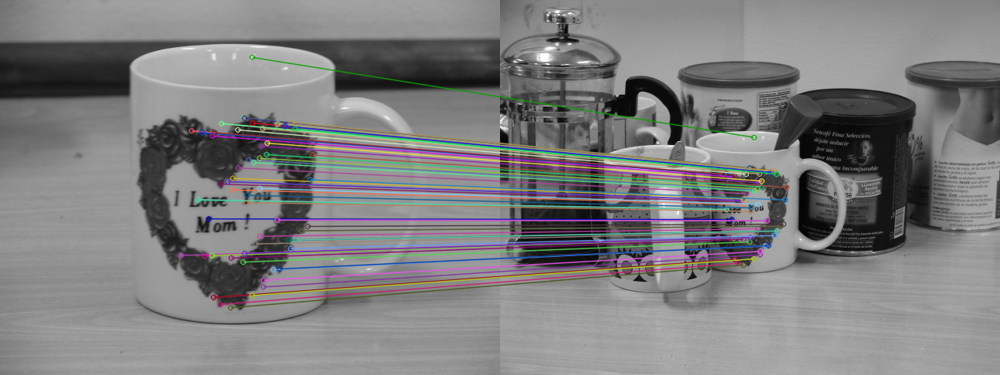

Resultado obtenido de la proyección con el método de Hough


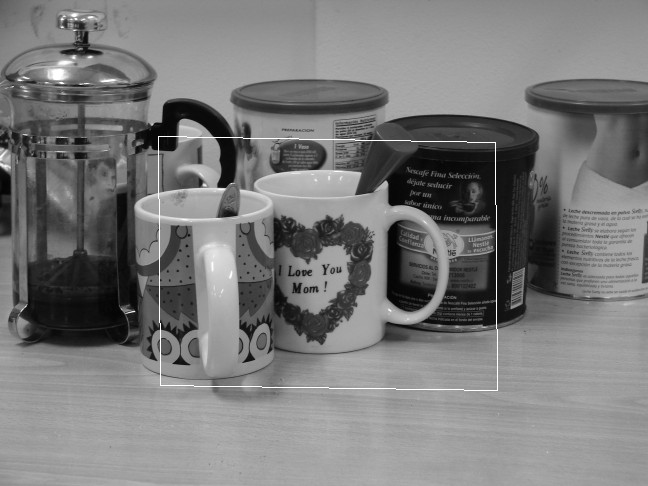

time: 860 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg')

### Imagen 2

Calces iniciales


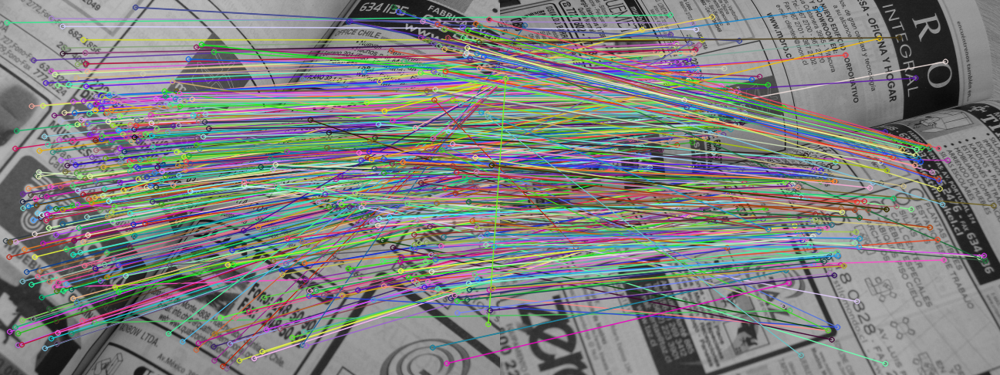

Calces aceptados mediante el método de Hough


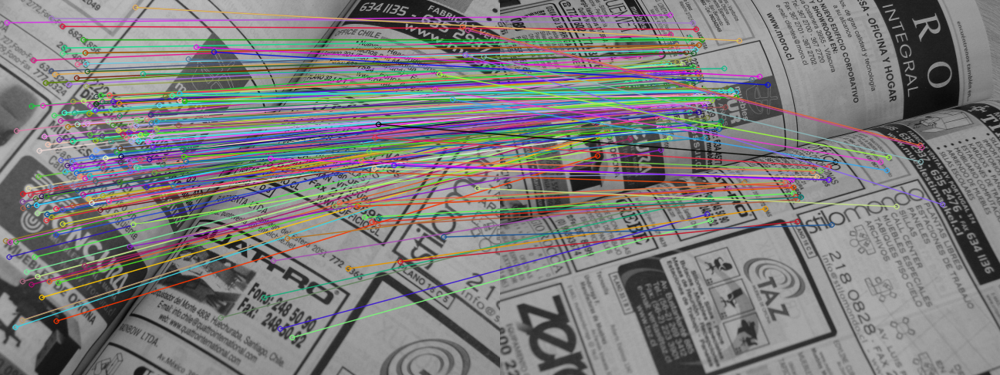

Resultado obtenido de la proyección con el método de Hough


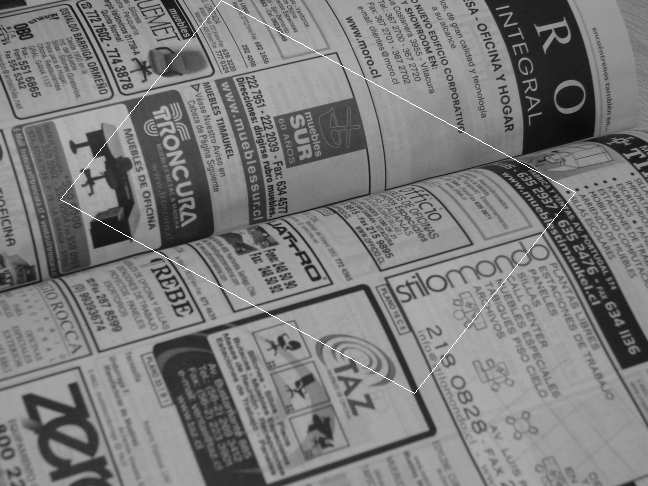

time: 1.8 s


In [ ]:
show_results_hough('uch084a.jpg','uch084b.jpg')

### Imagen 3

Calces iniciales


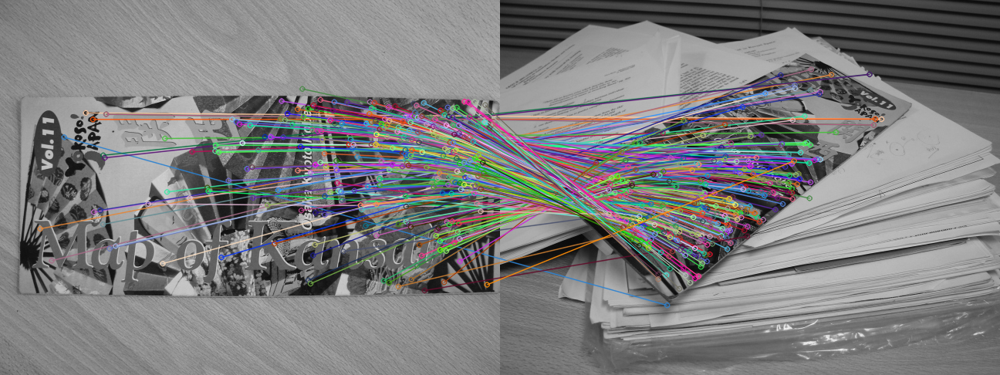

Calces aceptados mediante el método de Hough


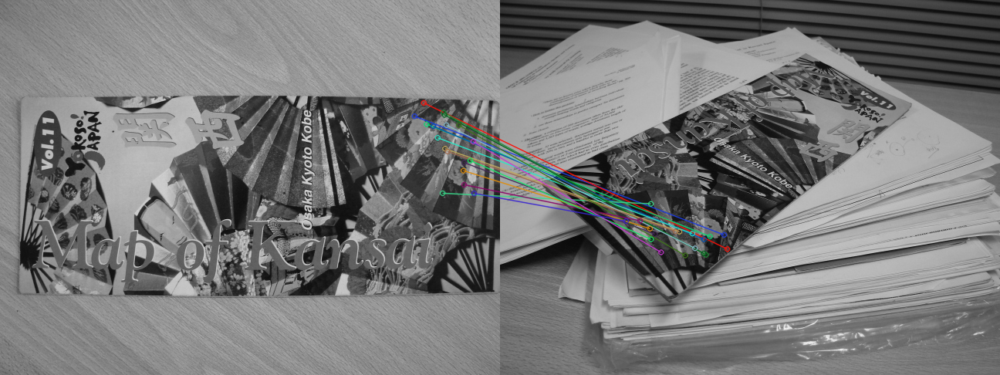

Resultado obtenido de la proyección con el método de Hough


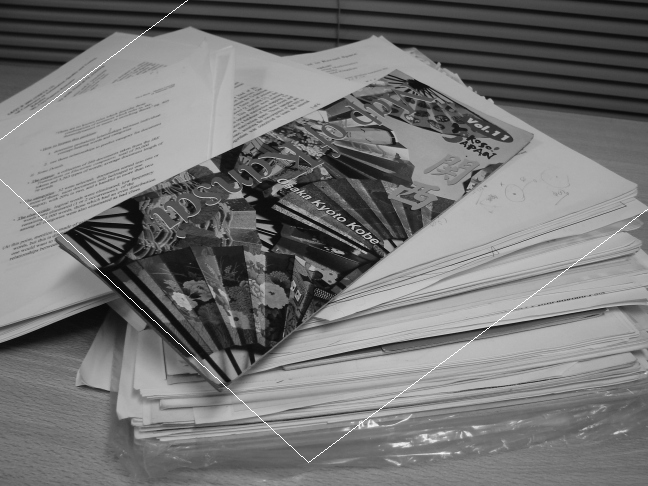

time: 1.1 s


In [ ]:
show_results_hough('uch098a.jpg','uch098b.jpg')

### Imagen 4

Calces iniciales


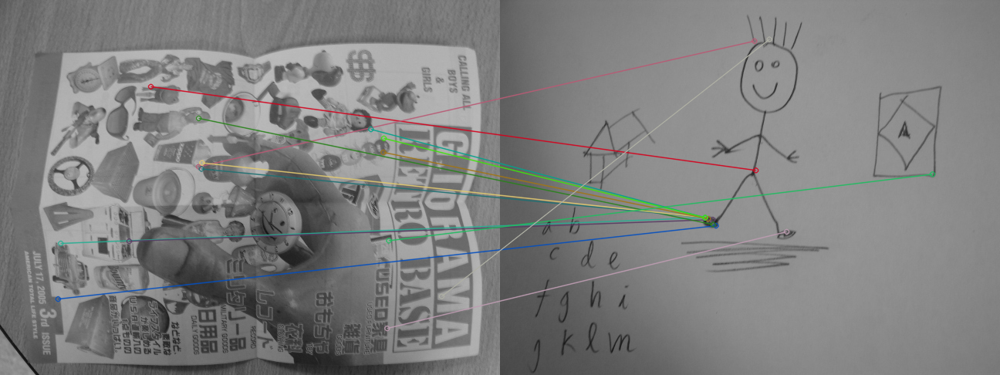

Calces aceptados mediante el método de Hough


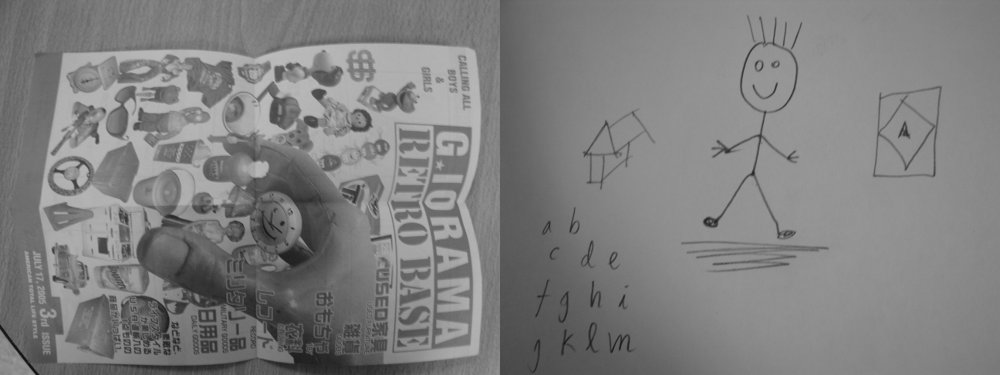

Resultado obtenido de la proyección con el método de Hough


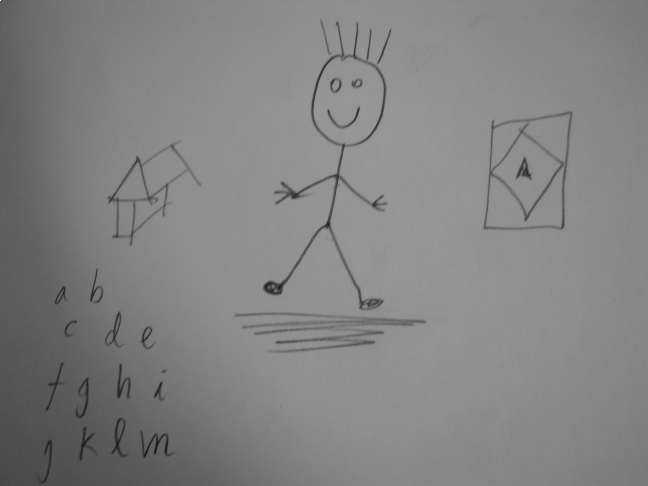

time: 1.03 s


In [ ]:
show_results_hough('uch101a.jpg','uch101b.jpg')

# Efecto de variar los parámetros de Ransac

Se escoge la imagen 1, para ver el efecto de variar los parámetros de ambos métodos.

## Numero de iteraciones

En primer lugar, se varía el número de iteraciones y en este caso particular, no se observan diferencias en los resultados. Incluso al realizar sólo una iteración, el resultado se mantiene, lo que puede significar que en los calces no existe una cantidad significativa de outliers. 

A pesar de esto, se espera que en una si existe una cantidad mayor de outliers, al bajar el número de iteraciones, sea menos probable encontrar un conjunto de calces óptimo.

Por otro lado, al aumentar la cantidad de iteraciones debiese aumentar la probabilidad de encontrar el conjunto de calces óptimo y además el tiempo de procesamiento sería mayor.

Calces iniciales


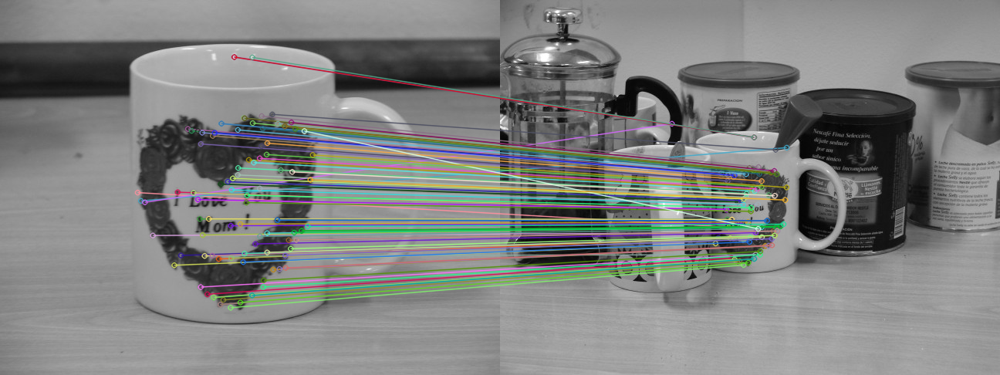

Calces aceptados mediante el método de Ransac


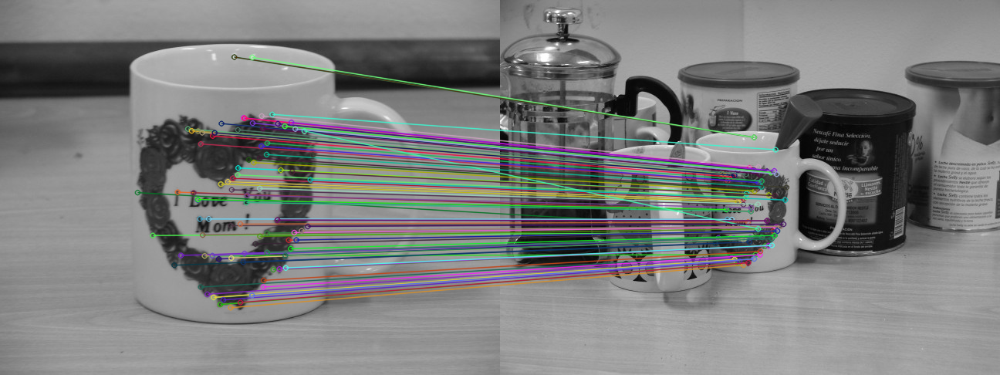

Resultado obtenido de la proyección con el método de Ransac


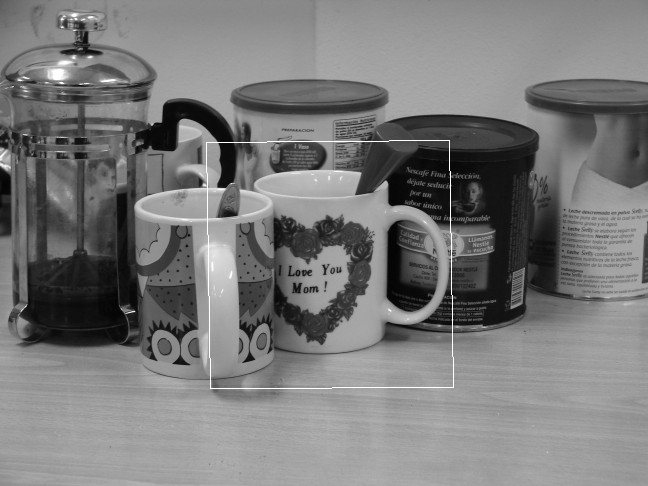

time: 807 ms


In [ ]:
show_results_ransac('uch012a.jpg','uch012b.jpg', k = 1)

## Umbral

Al variar el umbral, varía también la cantidad de calces aceptados por el método. A mayor umbral, se tiende a aceptar una mayor cantidad de calces, lo que puede llevar a transformaciones con mucho ruido. Por otro lado, a menor umbral, se aceptan menos calces, lo que puede resultar en una proyeción más certera, ya que se escogen los más confiables.

Es necesario mencionar que si el umbral es muy pequeño, eventualmente se podrían obtener muy pocos calces, y por ende se obtendría una proyección menos representativa.

Calces iniciales


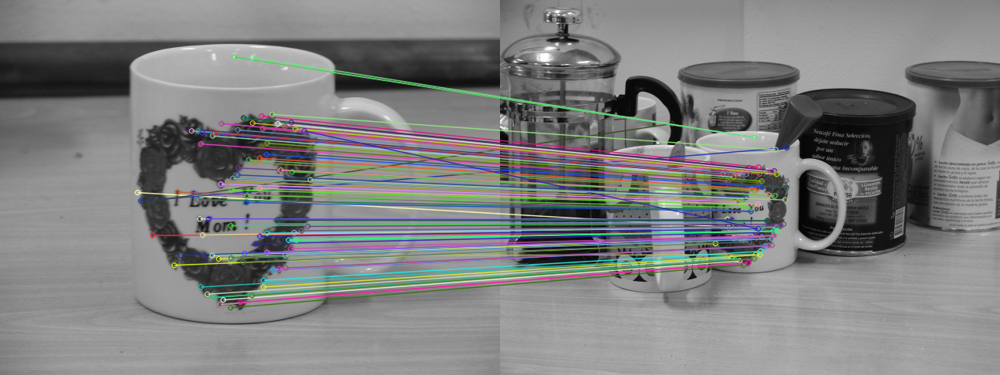

Calces aceptados mediante el método de Ransac


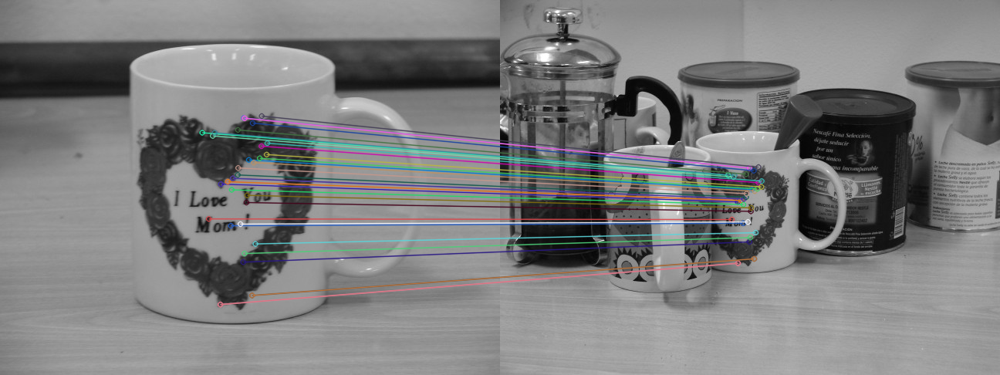

Resultado obtenido de la proyección con el método de Ransac


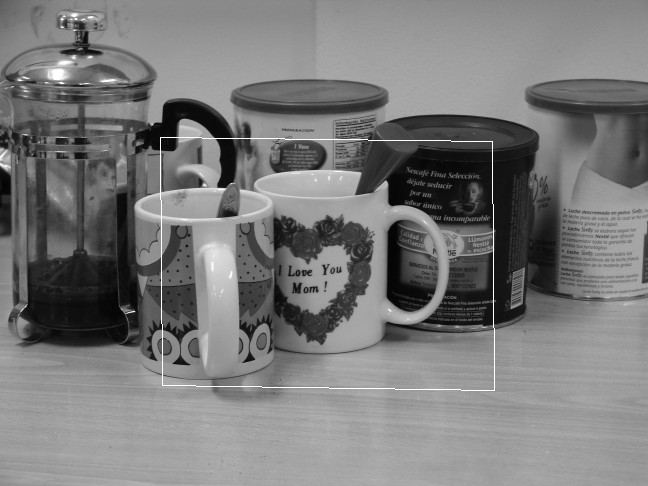

time: 913 ms


In [ ]:
show_results_ransac('uch012a.jpg','uch012b.jpg', t=0.5)

## Minimo de concenso

Se tiene que, en general, si el mínimo de concenso necesario es muy bajo, se pueden aceptar calces incorrectos lo que llevará a malas proyecciones. Por otro lado, si es muy alto, puede darse el caso de que no se termine aceptando ninguno, a pesar de que si exista un conjunto válido para hacer la proyección. Es por esto, que es muy importante ajustar bien este parámetro según sea el caso.

Calces iniciales


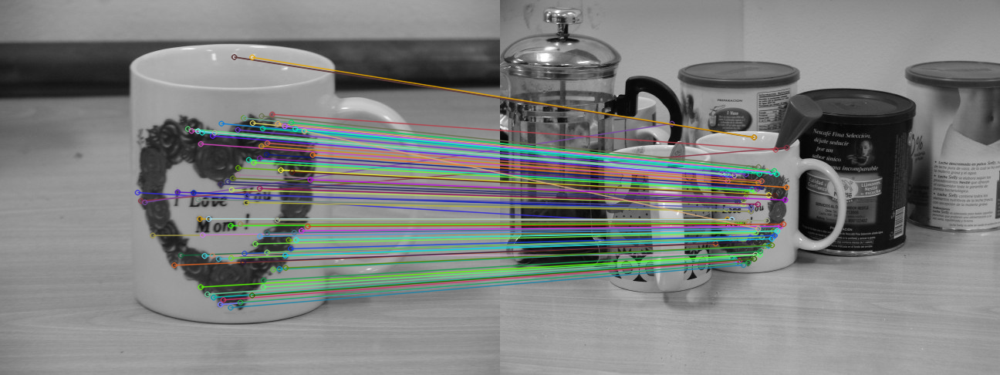

Calces aceptados mediante el método de Ransac


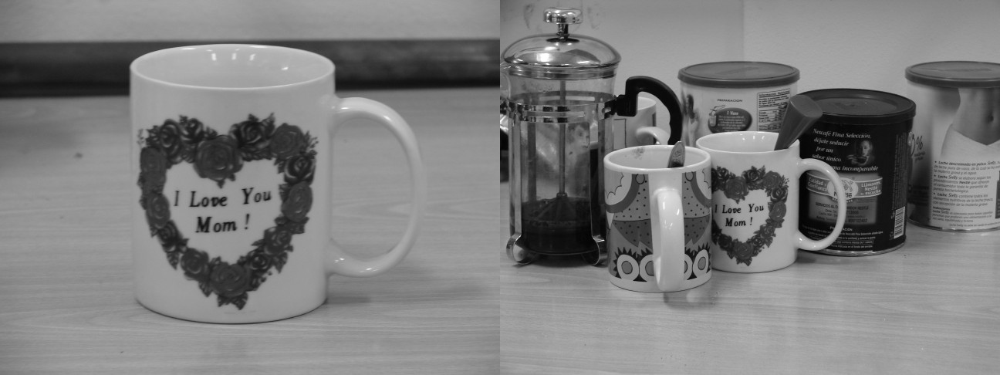

Resultado obtenido de la proyección con el método de Ransac


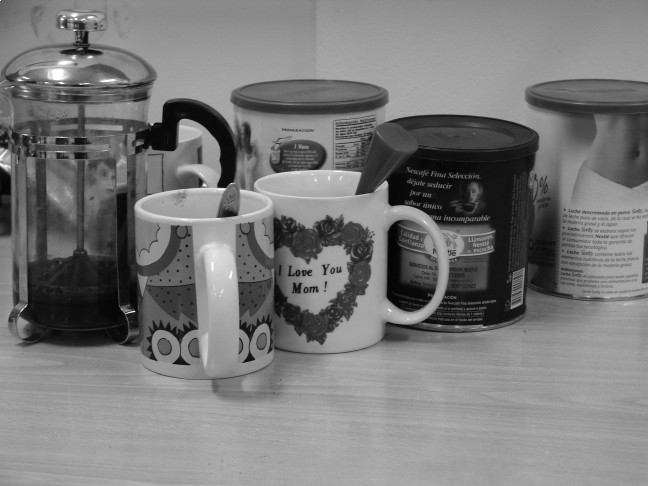

time: 955 ms


In [18]:
show_results_ransac('uch012a.jpg','uch012b.jpg', min_concenso=300)

# Efecto de variar los parámetros de Hough

## Bin x

Se tiene que, aumentar demasiado el tamaño del bin, resulta en que se acepten una mayor cantidad de calces debido a que hay mayor probabilidad de que estos voten por la misma celda. Esto puede resultar en proyecciones imprecisas ya que es más probable conservar ruido.

Por otro lado, hacer más fino el tamaño del bin, resulta en que se dispersen los votos, lo cual implica que se conservara una menor cantidad de calces. En el extremo (tamaño del bin muy pequeño), la cantidad de calces puede ser tan pequeña que no sirva para calcular una transformación adecuada.


Calces iniciales


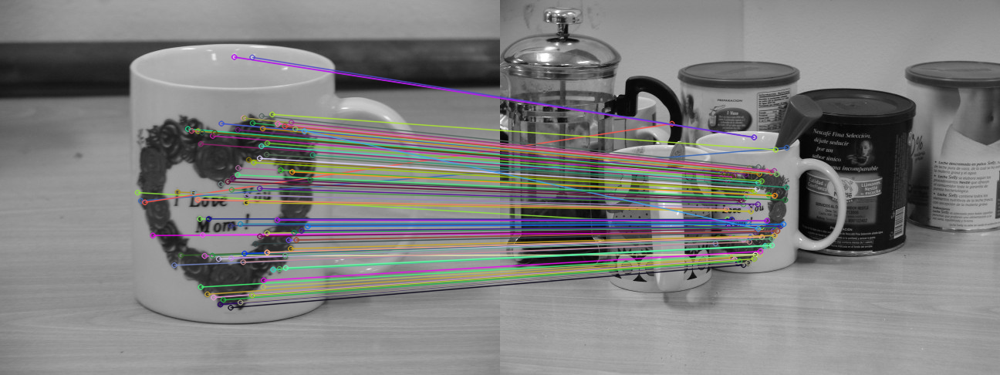

Calces aceptados mediante el método de Hough


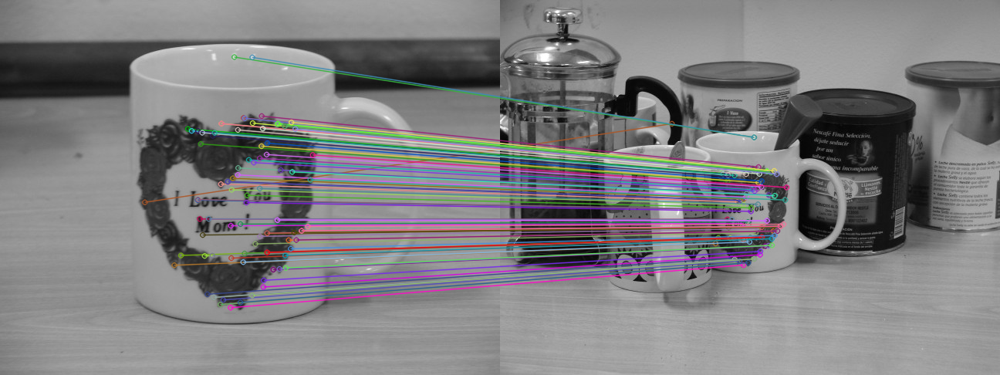

Resultado obtenido de la proyección con el método de Hough


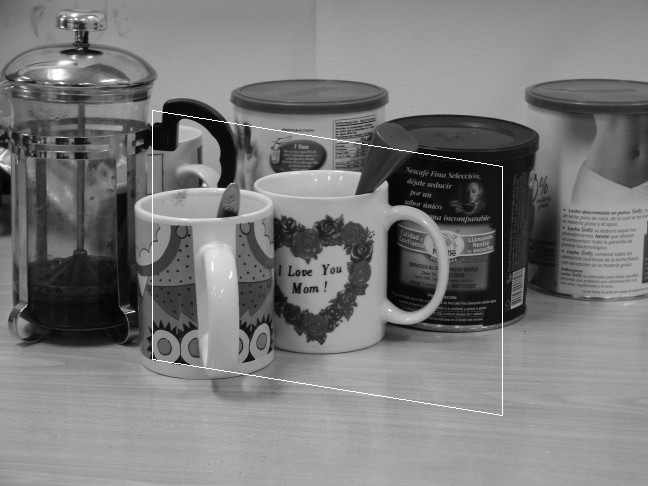

time: 821 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg', dxBin=1000)

Calces iniciales


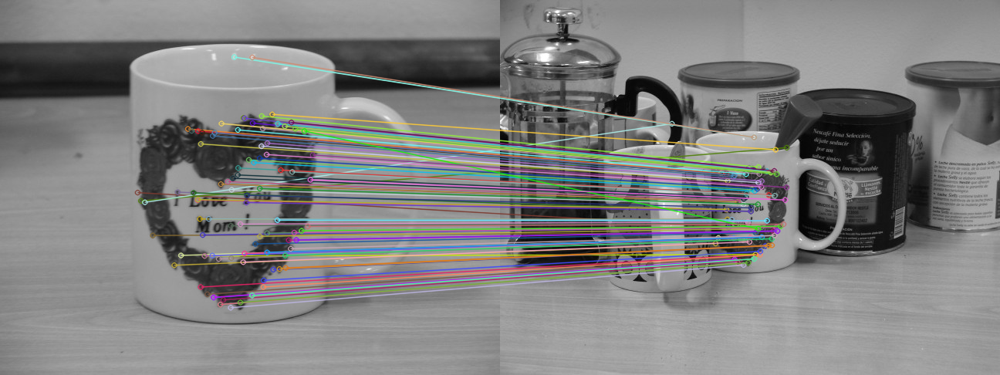

Calces aceptados mediante el método de Hough


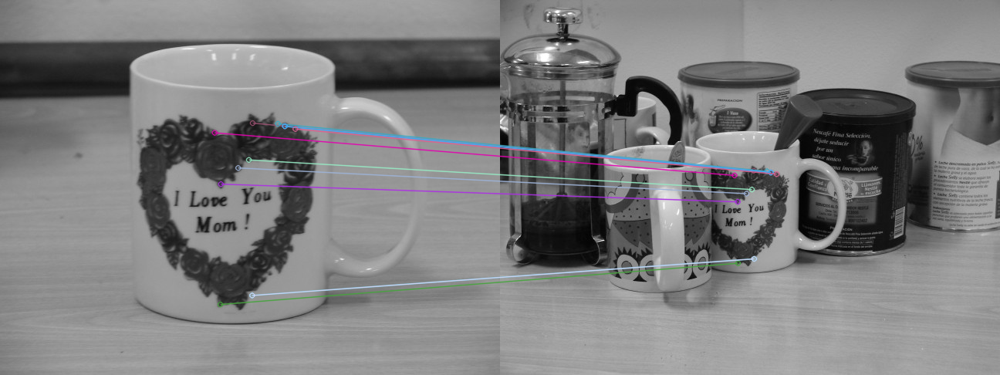

Resultado obtenido de la proyección con el método de Hough


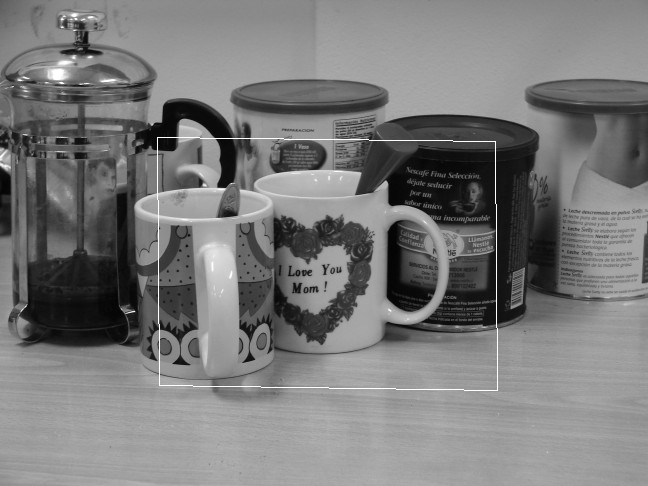

time: 823 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg', dxBin=10)

## Bin de ángulo

El análisis es similar al de variar el tamaño del bin x, ya que se obtiene una mayor cantidad de calces al agrandar el tamaño del bin de ángulo, y por otro lado, se obtienen pocos calces al disminuir el tamaño de éste.

Calces iniciales


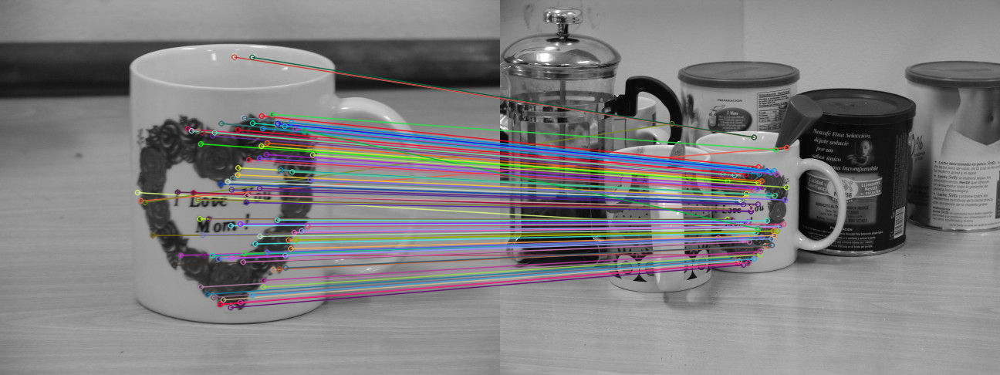

Calces aceptados mediante el método de Hough


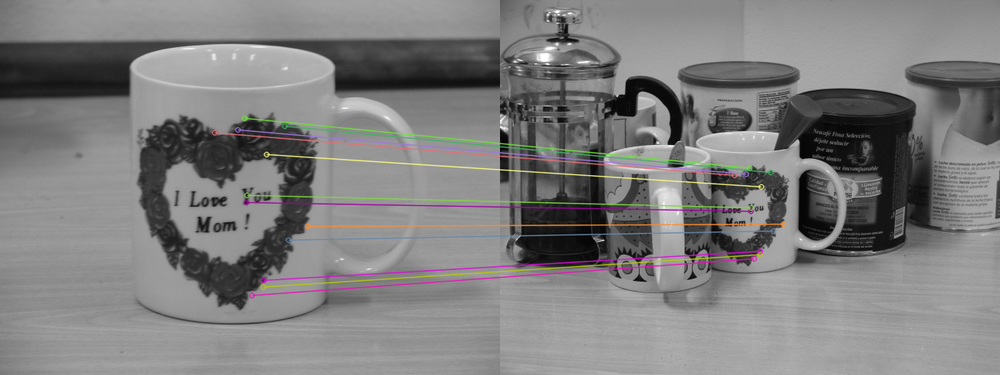

Resultado obtenido de la proyección con el método de Hough


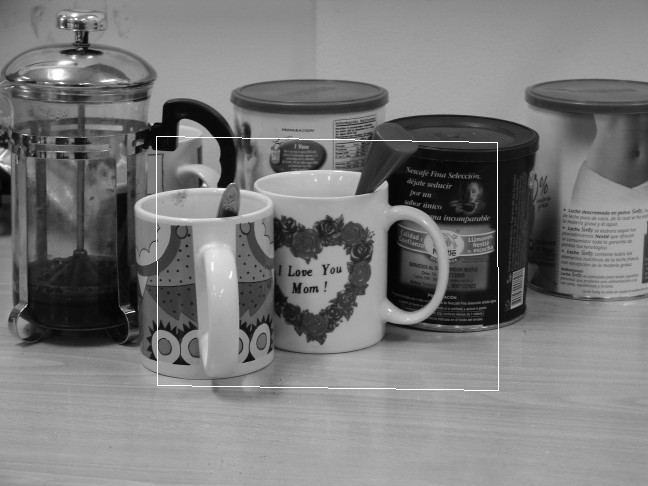

time: 853 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg', dangBin=1)

Calces iniciales


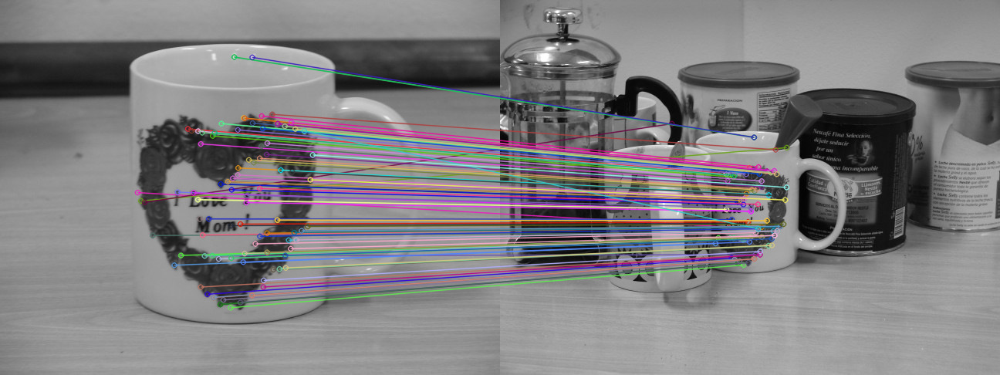

Calces aceptados mediante el método de Hough


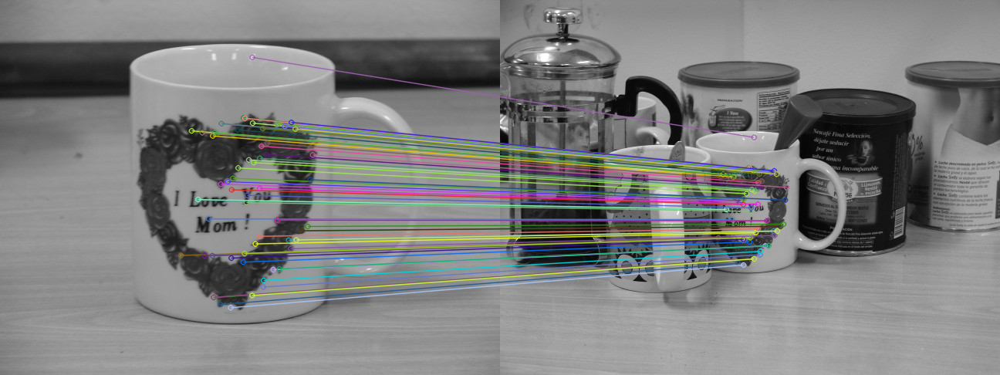

Resultado obtenido de la proyección con el método de Hough


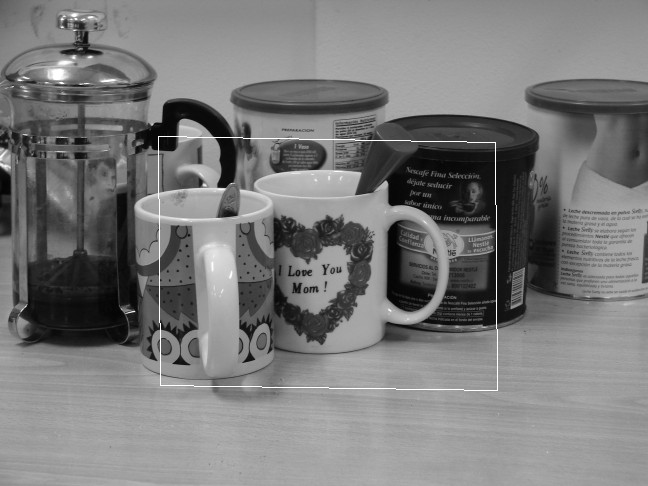

time: 805 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg', dangBin=360)

## Umbral de votos

Como se recoren todos los calces, variar el umbral de votos no tiene mucha complejidad. En un ejemplo en donde la transformación es correcta, disminuir el umbral no tiene efecto ya que la cantidad de votos se mantedrá. Por otro lado si es demasiado alta, el método no aceptaría ninguna transformación.


Calces iniciales


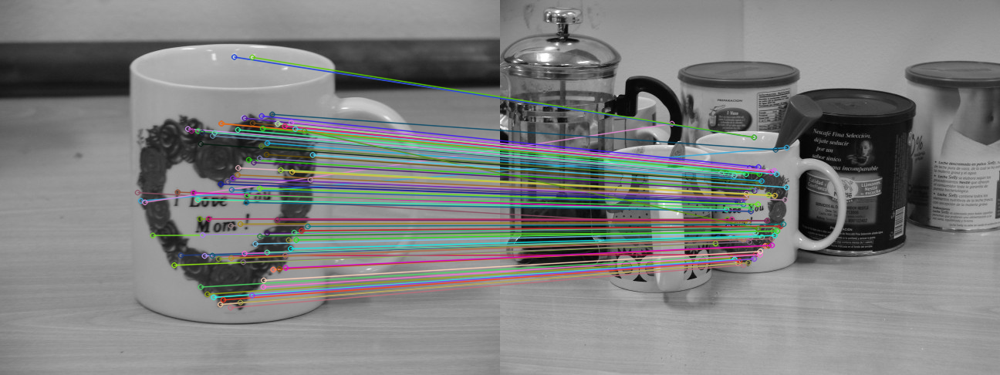

Calces aceptados mediante el método de Hough


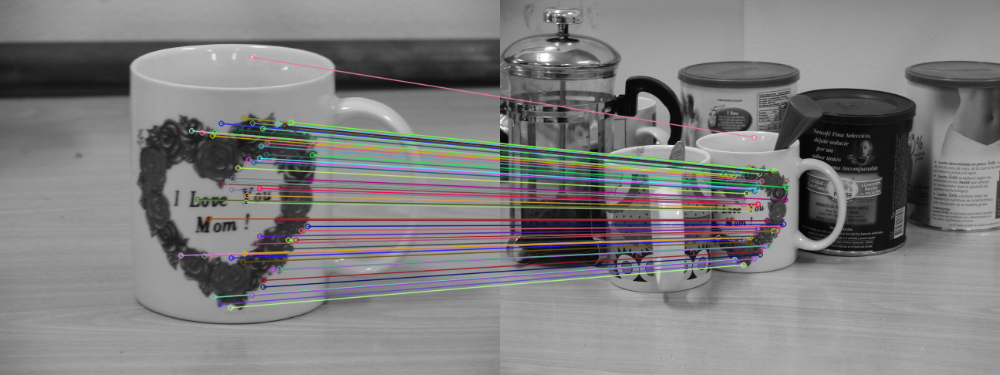

Resultado obtenido de la proyección con el método de Hough


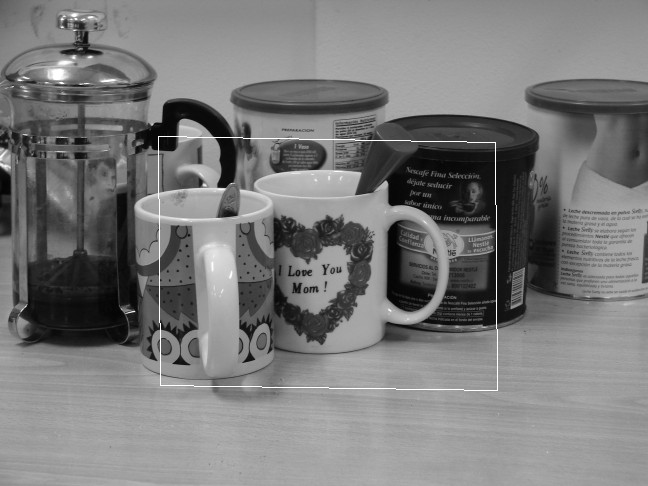

time: 824 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg', umbralvotos=1)

Calces iniciales


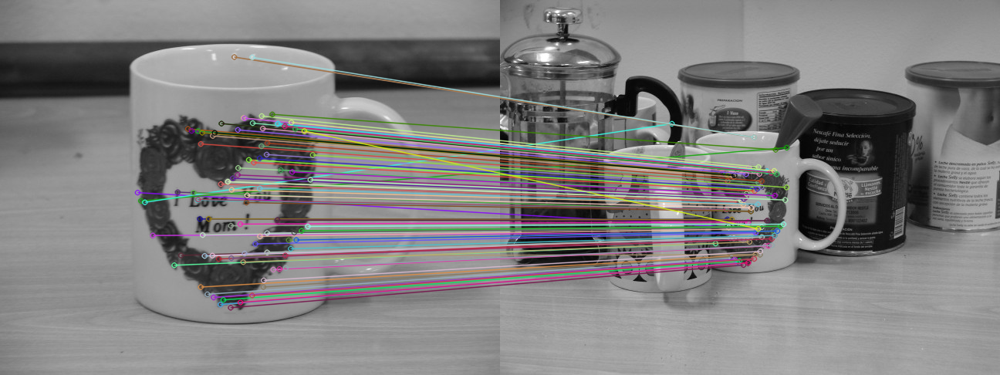

Calces aceptados mediante el método de Hough


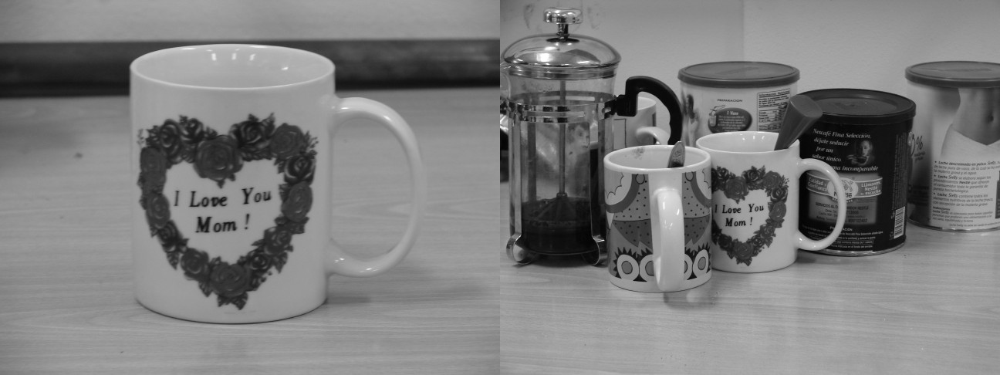

Resultado obtenido de la proyección con el método de Hough


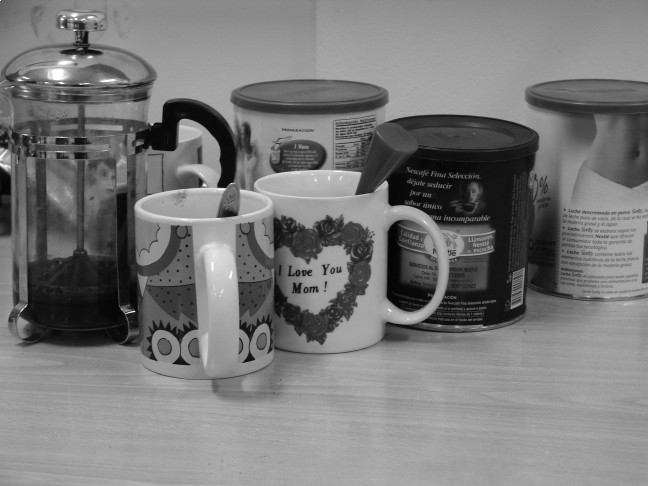

time: 778 ms


In [ ]:
show_results_hough('uch012a.jpg','uch012b.jpg',umbralvotos=100)

# Ventajas y desventajas de Ransac y Hough

De los resultados se puede notar que el método de Ransac permite abordar de mejor manera las rotaciones fuera del plano.
Por otro lado, el método de Hough en teoría debiese ser más robusto al ruido, ya que procesa todos los calces de forma independiente, a diferencia del método de Ransac, en el cual es necesario aumentar el número de iteraciones (y por ende el costo computacional), para ser más preciso.

Además, se puede notar que apesar de que ambos métodos tengan la misma cantidad de parámetros, los del método de Ransac pueden ser más difíciles de optimizar, debido a que dependen en mayor medida del caso particular (por ejemplo, el número de iteraciones es necesario aumentarlo cuando los ejemplos contienen mayor ruido, lo cual en el caso de imágenes, no es posible identificarlo de manera rápida).

# Conclusiones

En el presente trabajo se logró implementar los métodos de Hough y de Ransac para la detección de objetos, incluyendo los métodos complementarios para que estos funcionen, como la transformación de semejanza y afín.
Además, se analizaron los resultados obtenidos sobre un conjunto de imágenes, y se mostraron los efectos de variar los parámetros de ambos métodos. Finalmente se analizan las ventajas y desventajas relativas de Ransac y Hough.

Los resultados obtenidos concuerdan con la teoría, a pesar de que es necesario probar los métodos sobre un conjunto más variado de imágenes para poder hacer un análisis más exacto.

El principal aprendizaje de esta tarea es el conocimiento práctico, en métodos para detectar objetos particulares, lo cual requiere de sistemas basados en descriptores.

La principal dificultad encontrada, es la comprensión del funcionamiento de los métodos, ya que en principio son algo confusos.

Se cree que una forma de mejorar los resultados es agregar un conjunto más amplio de imágenes de prueba, para observar de mejor manera el comportamiento de los métodos en distintas situaciones.